In [ ]:
%load_ext autoreload
%autoreload 2

In [2]:
import os
from owi_data_2_pandas.io import API
import datetime
from pytz import utc
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import numpy as np

# Import vub Meetenet Vlaamse Banken API functions
from vubmvbc.config import Credentials
from vubmvbc.client import Base
from vubmvbc.objects import Catalog, Data
import vubmvbc.data_getter as dg

from oma_tracking.oma_clustering import ModeClusterer, ModeClusterer_HDBSCAN  #pip install hdbscan --no-build-isolation --no-binary :all
from oma_tracking.data.make_dataset import get_mpe_data, DatasetGetter
from oma_tracking.data.utils import get_rated_data, get_parked_data, read_simulations_csv_files

c:\Users\Max\anaconda3\envs\soiltwin\lib\site-packages\numpy\_distributor_init.py:30: UserWarning: loaded more than 1 DLL from .libs:
c:\Users\Max\anaconda3\envs\soiltwin\lib\site-packages\numpy\.libs\libopenblas.4SP5SUA7CBGXUEOC35YP2ASOICYYEQZZ.gfortran-win_amd64.dll
c:\Users\Max\anaconda3\envs\soiltwin\lib\site-packages\numpy\.libs\libopenblas.XWYDX2IKJW2NMTWSFYNGFUWKQU3LYTCZ.gfortran-win_amd64.dll
  warnings.warn("loaded more than 1 DLL from .libs:"
c:\Users\Max\anaconda3\envs\soiltwin\lib\site-packages\requests\__init__.py:102: RequestsDependencyWarning: urllib3 (1.26.9) or chardet (5.1.0)/charset_normalizer (2.0.12) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({})/charset_normalizer ({}) doesn't match a supported "


In [3]:
start =  datetime.datetime(2022,11,1,tzinfo=utc)
stop  = datetime.datetime(2023,3,1,tzinfo=utc)
location = 'nw2c02'
name_location = 'NW2_C02'
data_file_name = '_'.join([location, start.strftime("%Y%m%d"), stop.strftime("%Y%m%d")])
data_path = "../../data/nw2/raw/" + data_file_name + ".parquet"
weather_data_path = "../../data/nw2/mvbc_data.parquet"

dt_start =  datetime.datetime(2022,11,1,tzinfo=utc)
dt_stop  = datetime.datetime(2023,3,20,tzinfo=utc)
dsg = DatasetGetter(dt_start, dt_stop, location=location)
#dsg.get_longterm_data()
#dsg.save_data(data_path)

ConnectionError: HTTPConnectionPool(host='10.0.0.138', port=80): Max retries exceeded with url: /api/v1/metricsv2?location=nw2c02 (Caused by NewConnectionError('<urllib3.connection.HTTPConnection object at 0x000001E466A76040>: Failed to establish a new connection: [WinError 10060] A connection attempt failed because the connected party did not properly respond after a period of time, or established connection failed because connected host has failed to respond'))

In [263]:
turbine_data = pd.read_parquet(data_path)
weather_data = pd.read_parquet(weather_data_path)

In [6]:
name_location = 'NW2_C02'
mpe_data = {}
directions = ['SS', 'FA']
for direction in directions:
    mpe_data[direction] = get_mpe_data(turbine_data, direction, name_location)

In [7]:
def select_max_row(data, selection_column):
    """
    Selects the row with the highest value of a specific column when the index is duplicated in a dataframe.
    :param data: The dataframe to select rows from.
    :param selection_column: The name of the column to select the maximum of.
    :return: A dataframe with the selected rows.
    """
    max_rows = data.groupby(data.index).apply(lambda x: x.loc[x[selection_column].idxmax()])
    return max_rows

In [501]:
mc = {}
clustering_data = {}
clustered_modes = {}
modes = {}

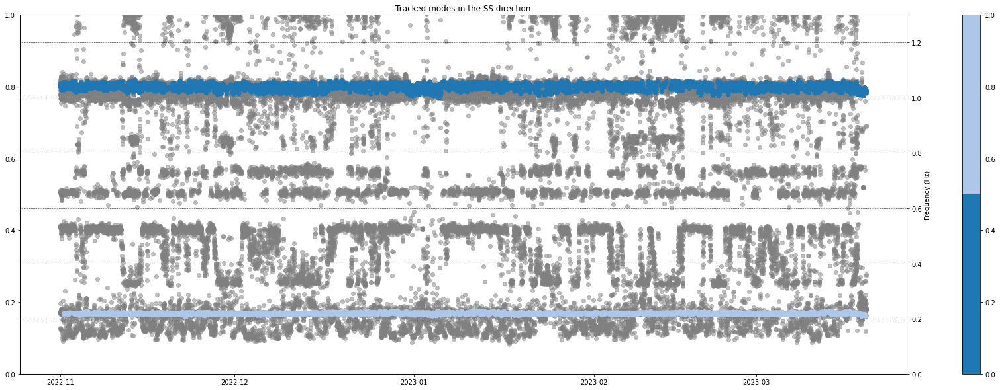

In [506]:
direction = 'SS'
mc[direction] = ModeClusterer(
    eps = 4,
    min_samples = 15,
    multipliers = {"frequency": 500, "size": 10, "damping": 10},
    index_divider = 1000,
    cols = ["frequency", "size", "damping"],
    min_size = 10,
    max_damping = 10,)

clustering_data[direction] = mpe_data[direction].rename(columns={'mean_frequency':'frequency', 'mean_damping':'damping', 'size':'size'})
mc[direction].fit(clustering_data[direction])
clustered_modes[direction] = mc[direction].predict(min_cluster_size=1000)

fig, ax2 = plt.subplots(figsize = (30,10))
#ax2.plot(turbine_data.filter(like='rpm').index, turbine_data.filter(like='rpm').values, color='k', alpha=1, label='RPM')
ax1 = ax2.twinx()
ax1.scatter(clustering_data[direction].index, clustering_data[direction]['frequency'], alpha=0.5, color='grey')

tab10 = plt.get_cmap('tab20')
first_colors = tab10(range(0,len(clustered_modes[direction].labels.unique()),1))
cmap = ListedColormap(first_colors)

im = ax1.scatter(clustered_modes[direction].index, clustered_modes[direction]['frequency'], c=clustered_modes[direction]['labels'], cmap = cmap)
plt.grid(True, color='k', linestyle='--', linewidth=0.5)
cbar = plt.colorbar(im, ax=ax1)
plt.xlabel('Time (YYYY-MM)')
plt.ylabel('Frequency (Hz)')
plt.title('Tracked modes in the SS direction')
plt.ylim(0, 1.3)

plt.show()

SS1 = clustered_modes[direction][clustered_modes[direction].labels == 1]
SS1 = SS1[~SS1.index.duplicated()].reindex(clustering_data[direction][~clustering_data[direction].index.duplicated()].index)
SS2 = clustered_modes[direction][clustered_modes[direction].labels == 0]
SS2 = SS2[~SS2.index.duplicated()].reindex(clustering_data[direction][~clustering_data[direction].index.duplicated()].index)

In [507]:
direction = 'SS'
label_mode1 = 1
label_mode2 = 0

modes[direction + '1'] = clustered_modes[direction][clustered_modes[direction].labels == label_mode1]
modes[direction + '1'] = \
    modes[direction + '1'][~modes[direction + '1'].index.duplicated()]\
        .reindex(clustering_data[direction][~clustering_data[direction].index.duplicated()].index)

modes[direction + '2'] = clustered_modes[direction][clustered_modes[direction].labels == label_mode2]
modes[direction + '2'] = \
    modes[direction + '2'][~modes[direction + '2'].index.duplicated()]\
        .reindex(clustering_data[direction][~clustering_data[direction].index.duplicated()].index)

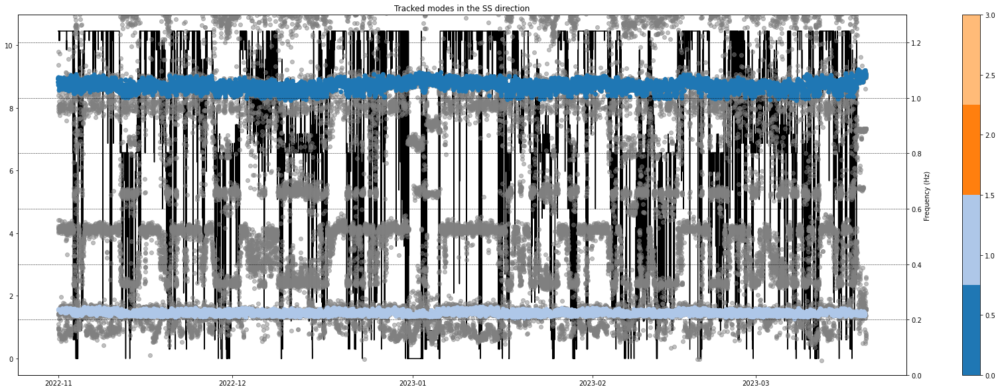

In [512]:
direction = 'FA'
mc[direction] = ModeClusterer(
    eps = 4,
    min_samples = 20,
    multipliers = {"frequency": 500, "size": 2, "damping": 1},
    index_divider = 2000,
    cols = ["frequency", "size", "damping"],
    min_size = 10,
    max_damping = 10,)

clustering_data[direction] = mpe_data[direction].rename(columns={'mean_frequency':'frequency', 'mean_damping':'damping', 'size':'size'})
mc[direction].fit(clustering_data[direction])
clustered_modes[direction] = mc[direction].predict(min_cluster_size=1000)

fig, ax2 = plt.subplots(figsize = (30,10))
ax2.plot(turbine_data.filter(like='rpm').index, turbine_data.filter(like='rpm').values, color='k', alpha=1, label='RPM')
ax1 = ax2.twinx()
ax1.scatter(clustering_data[direction].index, clustering_data[direction]['frequency'], alpha=0.5, color='grey')

tab10 = plt.get_cmap('tab20')
first_colors = tab10(range(0,len(clustered_modes[direction].labels.unique()),1))
cmap = ListedColormap(first_colors)

im = ax1.scatter(clustered_modes[direction].index, clustered_modes[direction]['frequency'], c=clustered_modes[direction]['labels'], cmap = cmap)
plt.grid(True, color='k', linestyle='--', linewidth=0.5)
cbar = plt.colorbar(im, ax=ax1)
plt.xlabel('Time (YYYY-MM)')
plt.ylabel('Frequency (Hz)')
plt.title('Tracked modes in the SS direction')
plt.ylim(0, 1.3)
plt.show()

FA1 = clustered_modes[direction][clustered_modes[direction].labels == 1]
FA1 = FA1[~FA1.index.duplicated()].reindex(clustering_data[direction][~clustering_data[direction].index.duplicated()].index)
FA2 = clustered_modes[direction][clustered_modes[direction].labels == 0]
FA2 = FA2[~FA2.index.duplicated()].reindex(clustering_data[direction][~clustering_data[direction].index.duplicated()].index)

In [509]:
tracked_frequencies = \
    pd.DataFrame(
        {
            'SS1': SS1['frequency'],
            'SS2': SS2['frequency'],
            'FA1': FA1['frequency'],
            'FA2': FA2['frequency'],
        }
    )

tracked_frequencies.to_parquet('../../data/nw2/tracked_modes/' + location + '.parquet', compression='gzip')

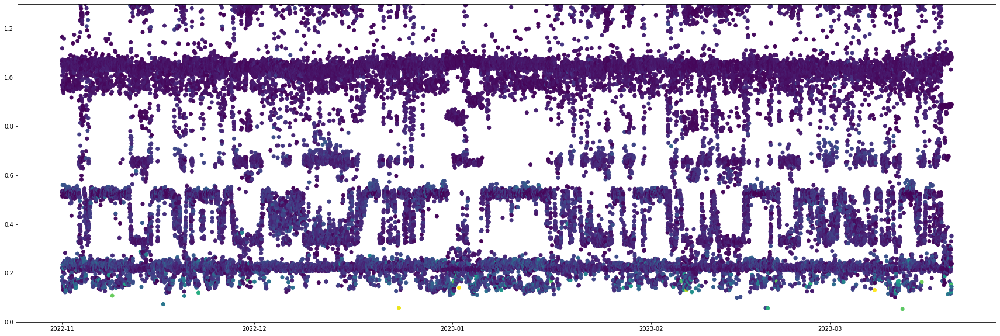

In [12]:
plt.figure(figsize=(30,10))
plt.scatter(clustering_data[direction].index, clustering_data[direction].frequency, c=clustering_data[direction]['damping'], alpha=1, cmap='viridis')
plt.ylim(0, 1.3)
plt.show()

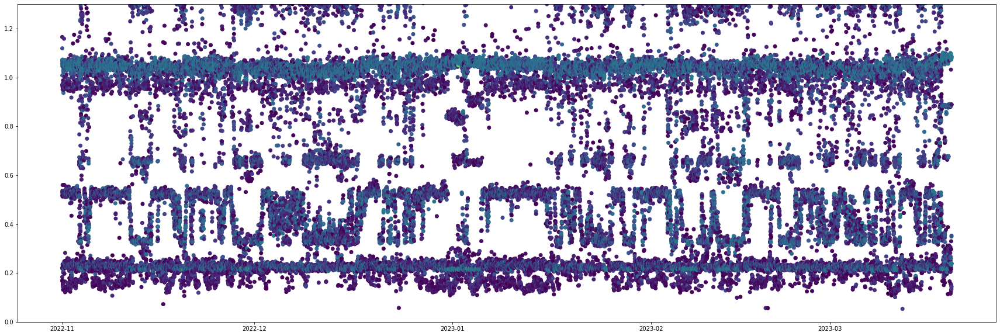

In [13]:
plt.figure(figsize=(30,10))
plt.scatter(clustering_data[direction].index, clustering_data[direction].frequency, c=clustering_data[direction]['size'], alpha=1, cmap='viridis')
plt.ylim(0, 1.3)
plt.show()

In [14]:
direction = 'FA'
label_mode1 = 1
label_mode2 = 0

modes[direction + '1'] = clustered_modes[direction][clustered_modes[direction].labels == label_mode1]
modes[direction + '1'] = \
    modes[direction + '1'][~modes[direction + '1'].index.duplicated()]\
        .reindex(clustering_data[direction][~clustering_data[direction].index.duplicated()].index)

modes[direction + '2'] = clustered_modes[direction][clustered_modes[direction].labels == label_mode2]
modes[direction + '2'] = \
    modes[direction + '2'][~modes[direction + '2'].index.duplicated()]\
        .reindex(clustering_data[direction][~clustering_data[direction].index.duplicated()].index)

# Harmonics

### Theoretical harmonic modes based on the rpm in the SCADA data

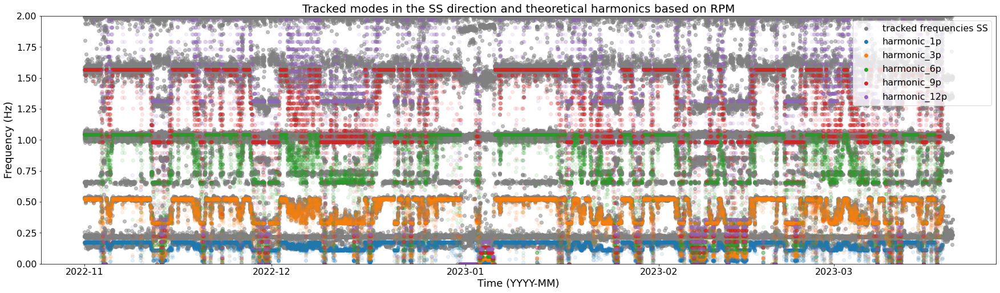

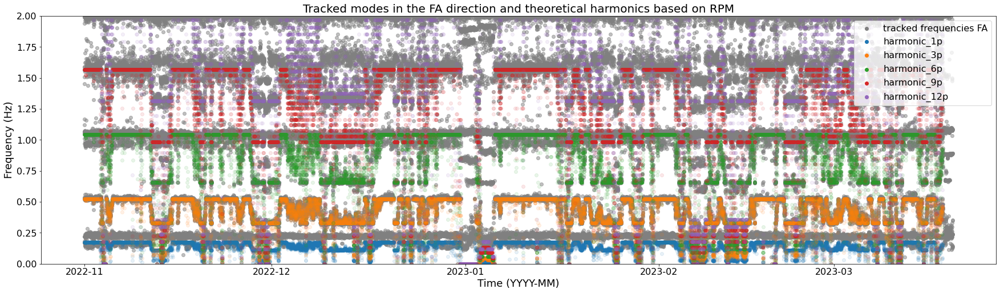

In [264]:
from oma_tracking.modal_tracking.harmonics import theoretical_harmonic
theoretical_harmonics = theoretical_harmonic(turbine_data, p_orders=[1,3,6,9,12])

for direction in ['SS', 'FA']:
    plt.figure(figsize = (30,8))
    plt.scatter(clustering_data[direction].index, clustering_data[direction].frequency, c='grey', alpha=0.5, label = 'tracked frequencies ' + direction)
    for col in theoretical_harmonics.columns:
        plt.scatter(theoretical_harmonics[col].index, theoretical_harmonics[col].values, alpha=0.1, label=col)
    plt.ylim(0, 2)
    plt.title('Tracked modes in the ' + direction + ' direction and theoretical harmonics based on RPM', fontsize=20)
    plt.xlabel('Time (YYYY-MM)', fontsize=18)
    plt.ylabel('Frequency (Hz)', fontsize=18)
    plt.xticks(fontsize=16)
    plt.yticks(fontsize=16)
    legend = plt.legend(loc='upper right', fontsize=16)
    for handle in legend.legendHandles:
        handle.set_alpha(1.0)
    plt.show()

### Cluster harmonics based on linear trend in Freq-RPM plot

In [330]:
from oma_tracking.modal_tracking.harmonics import HarmonicDetector
for direction in ['SS', 'FA']:
    harmonic_detector = HarmonicDetector(turbine_data, clustering_data[direction], p_orders=[3,6,9,12])
    distance_calculator_data = harmonic_detector.get_distance_calculator_data()

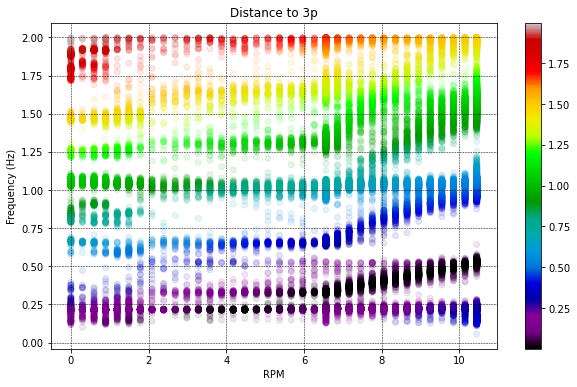

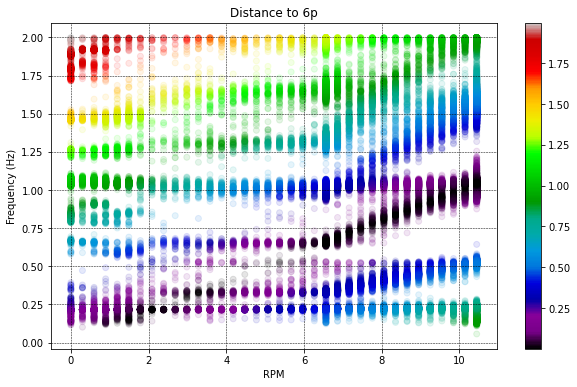

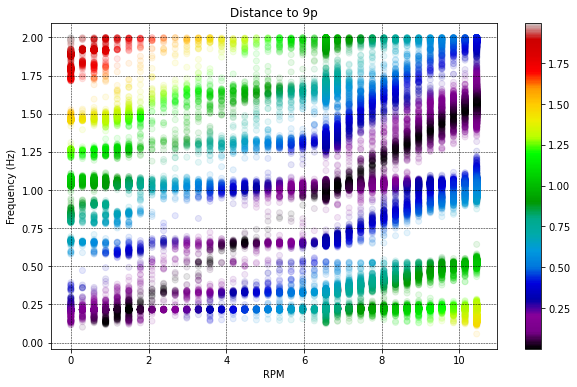

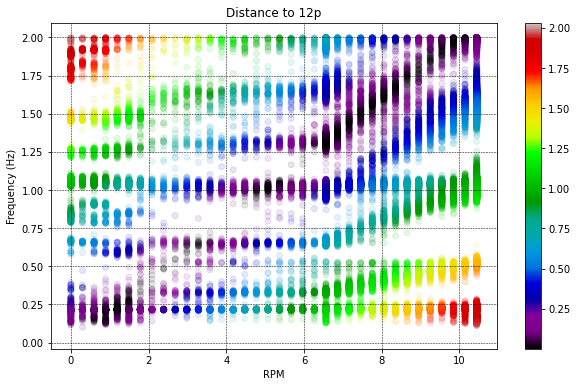

In [332]:
for p_harmonic in harmonic_detector.p_orders:
    harmonic_detector.plot_distances_p(p_harmonic=p_harmonic)

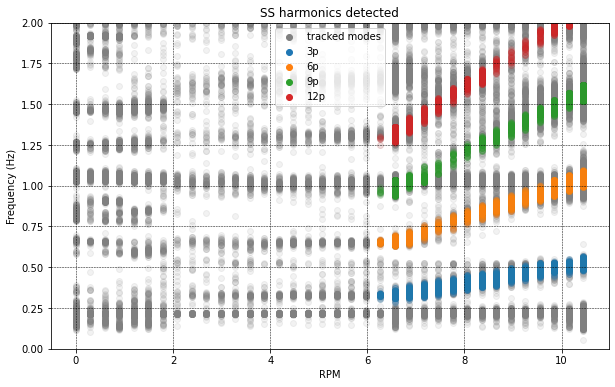

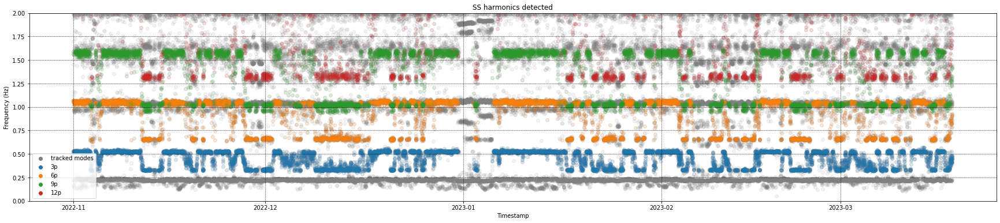

In [337]:
harmonic_detector.plot_distances()

In [349]:
harmonic_detector.get_plot_distance_data().filter(regex='distance').min(axis=1) > 0.1

timestamp
2022-11-01 00:00:00+00:00    False
2022-11-01 00:00:00+00:00    False
2022-11-01 00:10:00+00:00    False
2022-11-01 00:10:00+00:00    False
2022-11-01 00:10:00+00:00    False
                             ...  
2023-03-19 23:50:00+00:00    False
2023-03-20 00:00:00+00:00    False
2023-03-20 00:00:00+00:00    False
2023-03-20 00:00:00+00:00    False
2023-03-20 00:00:00+00:00    False
Length: 75736, dtype: bool

In [350]:
all_data = harmonic_detector.get_plot_distance_data()
harmonics_removed = harmonic_detector.get_plot_distance_data()[harmonic_detector.get_plot_distance_data().filter(regex='distance').min(axis=1) > 0.1]

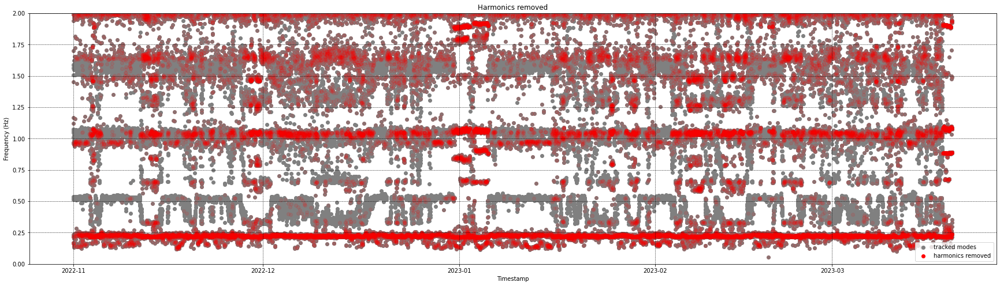

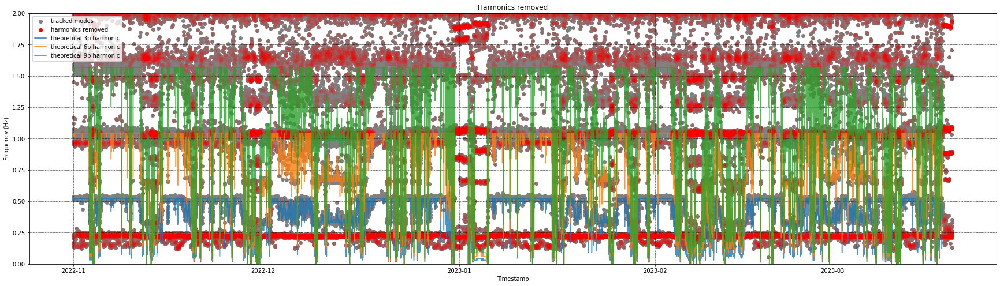

In [495]:
harmonic_detector.plot_harmonics_removed()
harmonic_detector.plot_harmonics_removed(plot_theoretical_harmonic=True)

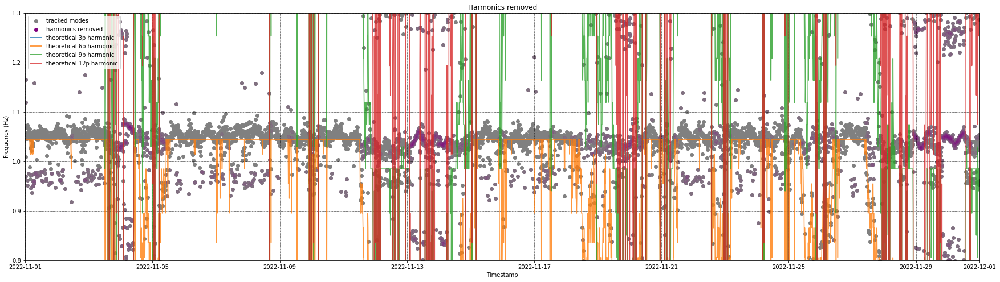

c:\Users\Max\anaconda3\envs\soiltwin\lib\site-packages\IPython\core\pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


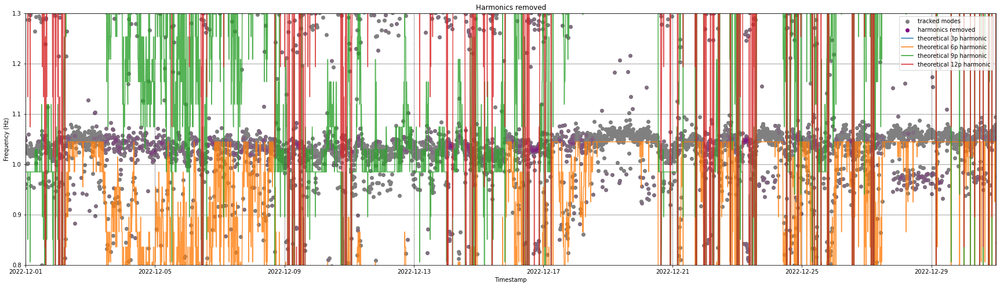

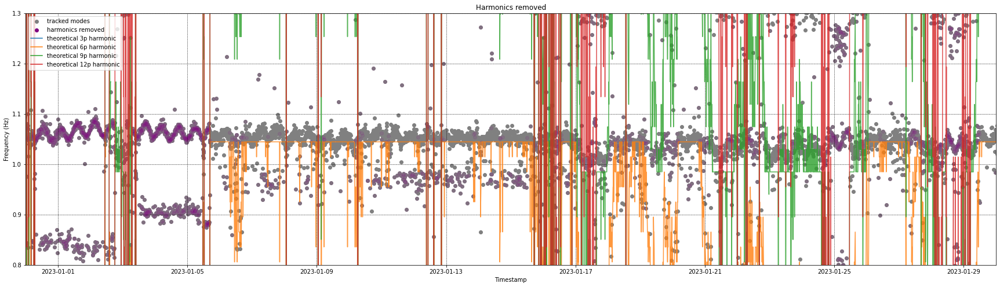

c:\Users\Max\anaconda3\envs\soiltwin\lib\site-packages\IPython\core\pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


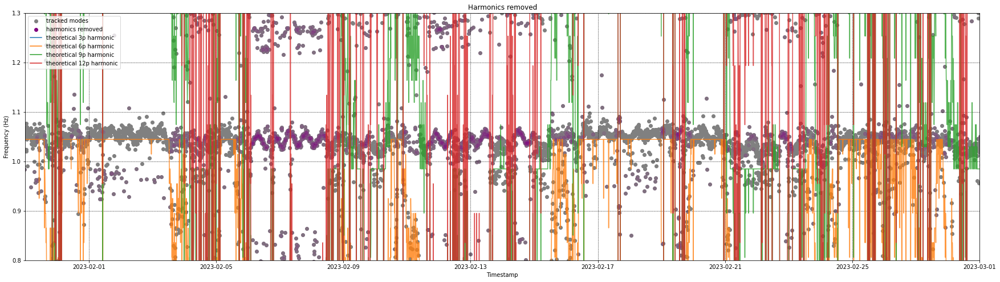

In [497]:
from pytz import utc
import datetime

start = datetime.datetime(2022, 11, 1, tzinfo=utc)

while start + datetime.timedelta(days=30) < harmonics_removed.index[-1]:
    end = start + datetime.timedelta(days=30)
    harmonic_detector.plot_harmonics_removed(
        plot_theoretical_harmonic = True,
        ylim = (0.8, 1.3),
        xlim=(start, end)
    )
    start = end

In [377]:
all_data = harmonic_detector.get_plot_distance_data()
harmonics = harmonic_detector.remove_harmonics()

In [381]:
all_data.reset_index(inplace=True)

In [448]:
min_rpm_data = all_data[(all_data.filter(regex='rpm') > 5).values]
harmonics = \
            min_rpm_data[ \
                min_rpm_data.filter(regex='distance').min(axis=1) \
                < 0.06 \
                ]
harmonics_removed = all_data[~all_data.index.isin(harmonics.index)]
harmonics_removed.set_index('timestamp', inplace=True)

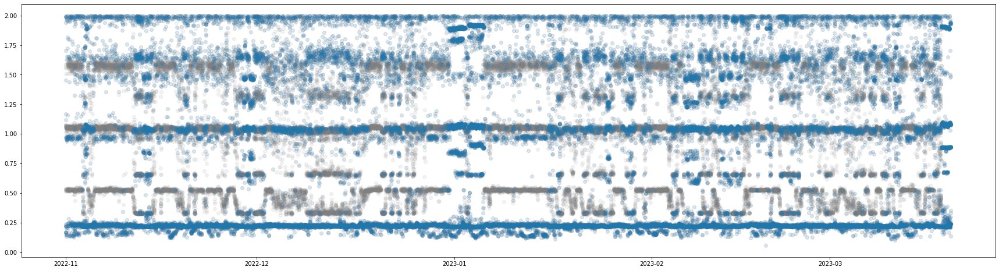

In [455]:
plt.figure(figsize=(30,8))
plt.scatter(
            harmonic_detector.get_plot_distance_data().index,
            harmonic_detector.get_plot_distance_data()['frequency'],
            alpha=0.1,
            color='grey',
            label = 'tracked modes'
        )
plt.scatter(
            harmonics_removed.index,
            harmonics_removed['frequency'],
            alpha=0.1,
            label = 'harmonics removed',
            color='#1f77b4'
        )

,algorithm,damping,frequency,size,std_damping,std_frequency,distance_3p,distance_6p,distance_9p,distance_12p,mean_NW2_C02_rpm
timestamp,,,,,,,,,,,
2022-11-01 00:00:00+00:00,lscf,3.602579,1.067735,41,0.262517,0.003296,0.545485,0.023235,0.499015,1.021265,10.445
2022-11-01 00:00:00+00:00,lscf,3.230206,1.590700,30,0.269245,0.007161,1.068450,0.546200,0.023950,0.498300,10.445
2022-11-01 00:10:00+00:00,lscf,0.607566,0.969517,21,0.294289,0.003600,0.447267,0.074983,0.597233,1.119483,10.445
2022-11-01 00:10:00+00:00,lscf,2.504403,1.056774,41,0.143047,0.000901,0.534524,0.012274,0.509976,1.032226,10.445
2022-11-01 00:10:00+00:00,lscf,2.492014,1.563402,30,0.276574,0.004854,1.041152,0.518902,0.003348,0.525598,10.445
...,...,...,...,...,...,...,...,...,...,...,...
2023-03-19 23:50:00+00:00,lscf,0.563403,1.928077,20,0.087795,0.002548,NaN,NaN,NaN,NaN,NaN
2023-03-20 00:00:00+00:00,lscf,1.017415,0.238219,41,0.123990,0.000222,NaN,NaN,NaN,NaN,NaN
2023-03-20 00:00:00+00:00,lscf,0.266679,0.889161,19,0.291210,0.003044,NaN,NaN,NaN,NaN,NaN


(0.8, 1.3)

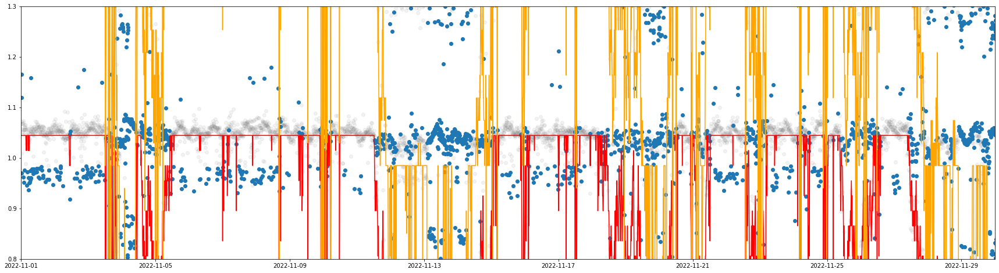

In [454]:
plt.figure(figsize=(30,8))
plt.scatter(
            harmonic_detector.get_plot_distance_data().index,
            harmonic_detector.get_plot_distance_data()['frequency'],
            alpha=0.1,
            color='grey',
            label = 'tracked modes'
        )
plt.scatter(
            harmonics_removed.index,
            harmonics_removed['frequency'],
            alpha=1,
            label = 'harmonics removed',
            color='#1f77b4'
        )
plt.plot(6/60 * harmonic_detector.get_plot_distance_data().filter(regex='rpm'), color='red', label='6/60 * rpm')
plt.plot(9/60 * harmonic_detector.get_plot_distance_data().filter(regex='rpm'), color='orange', label='6/60 * rpm')

plt.xlim(datetime.datetime(2022, 11, 1), datetime.datetime(2022, 11, 30))
plt.ylim(0.8,1.3)

In [369]:
mc = ModeClusterer(
    eps = 4,
    min_samples = 15,
    multipliers = {"frequency": 500, "size": 10, "damping": 10},
    index_divider = 1000,
    cols = ["frequency", "size", "damping"],
    min_size = 10,
    max_damping = 10,)
clustering_data = harmonics_removed
mc.fit(clustering_data)
clustered_modes = mc.predict(min_cluster_size=1000)

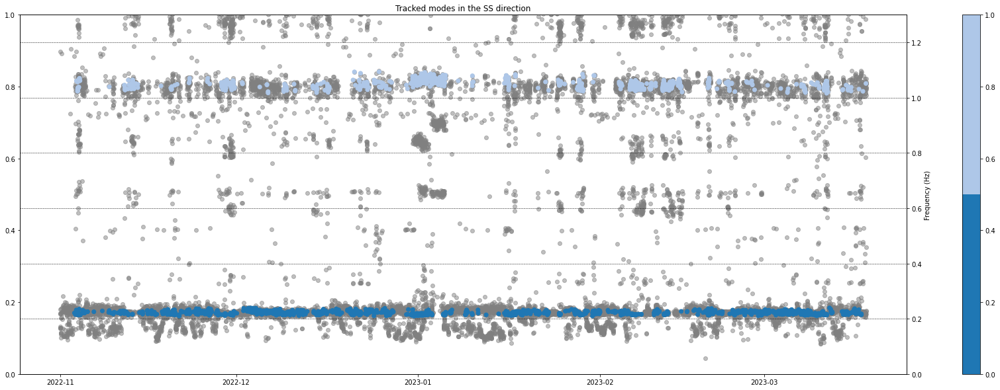

In [370]:
mc = ModeClusterer(
    eps = 4,
    min_samples = 15,
    multipliers = {"frequency": 500, "size": 10, "damping": 10},
    index_divider = 1000,
    cols = ["frequency", "size", "damping"],
    min_size = 10,
    max_damping = 10,)
clustering_data = harmonics_removed
mc.fit(clustering_data)

clustered_modes = mc.predict(min_cluster_size=1000)

fig, ax2 = plt.subplots(figsize = (30,10))
#ax2.plot(turbine_data.filter(like='rpm').index, turbine_data.filter(like='rpm').values, color='k', alpha=1, label='RPM')
ax1 = ax2.twinx()
ax1.scatter(clustering_data.index, clustering_data['frequency'], alpha=0.5, color='grey')

tab10 = plt.get_cmap('tab20')
first_colors = tab10(range(0,len(clustered_modes.labels.unique()),1))
cmap = ListedColormap(first_colors)

im = ax1.scatter(clustered_modes.index, clustered_modes['frequency'], c=clustered_modes['labels'], cmap = cmap)
plt.grid(True, color='k', linestyle='--', linewidth=0.5)
cbar = plt.colorbar(im, ax=ax1)
plt.xlabel('Time (YYYY-MM)')
plt.ylabel('Frequency (Hz)')
plt.title('Tracked modes in the SS direction')
plt.ylim(0, 1.3)

plt.show()

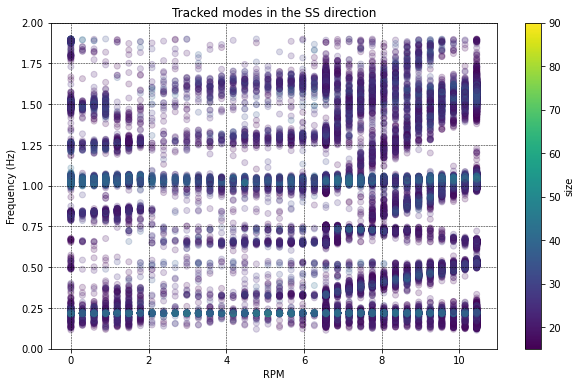

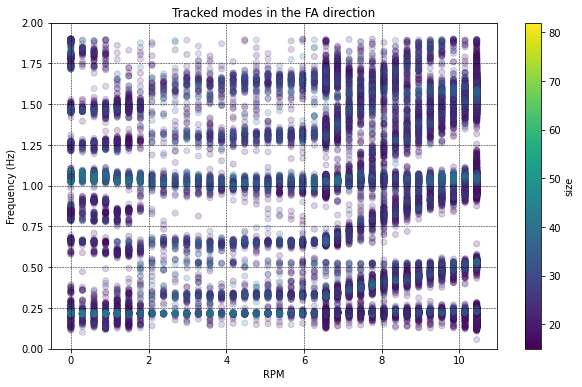

In [267]:
### Show the potential of cluster size for removing harmonics
for direction in ['SS', 'FA']:
    plt.figure(figsize = (10,6))
    plt_data = clustering_data[direction][clustering_data[direction].damping < 10]
    plt_data = plt_data[plt_data['frequency'] < 1.9]
    plt_rpm = turbine_data.filter(like='rpm').loc[plt_data.index]
    plt_data = pd.concat([plt_data, plt_rpm], axis=1)
    color_column = 'size'
    image = plt.scatter(plt_data.filter(regex='rpm'), plt_data['frequency'], alpha=0.2, c=plt_data[color_column], cmap = 'viridis')
    plt.grid(True, color='k', linestyle='--', linewidth=0.5)
    cbar = plt.colorbar(image, alpha=1.0, label=color_column)
    cbar.solids.set_alpha(1.0)
    plt.xlabel('RPM')
    plt.ylabel('Frequency (Hz)')
    plt.title('Tracked modes in the ' + direction + ' direction')
    plt.ylim(0, 2)
    plt.show()

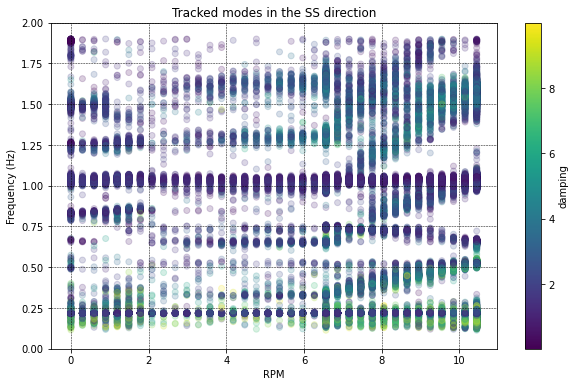

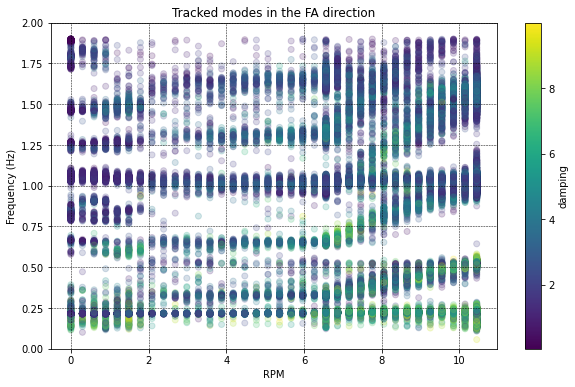

In [282]:
### Show the potential of damping for removing harmonics
for direction in ['SS', 'FA']:
    plt.figure(figsize = (10,6))
    plt_data = clustering_data[direction][clustering_data[direction].damping < 10]
    plt_data = plt_data[plt_data['frequency'] < 1.9]
    plt_rpm = turbine_data.filter(like='rpm').loc[plt_data.index]
    plt_data = pd.concat([plt_data, plt_rpm], axis=1)
    color_column = 'damping'
    image = plt.scatter(plt_data.filter(regex='rpm'), plt_data['frequency'], alpha=0.2, c=plt_data[color_column], cmap = 'viridis')
    plt.grid(True, color='k', linestyle='--', linewidth=0.5)
    cbar = plt.colorbar(image, alpha=1.0, label=color_column)
    cbar.solids.set_alpha(1.0)
    plt.xlabel('RPM')
    plt.ylabel('Frequency (Hz)')
    plt.title('Tracked modes in the ' + direction + ' direction')
    plt.ylim(0, 2)
    plt.show()

<Figure size 720x432 with 0 Axes>

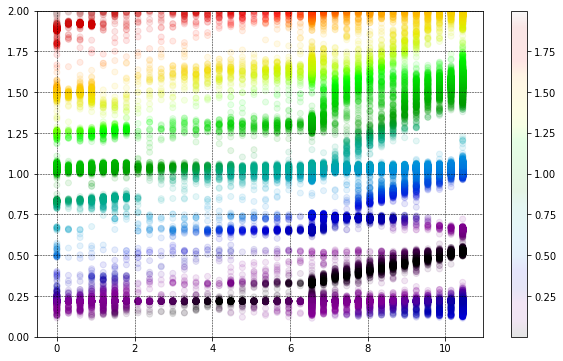

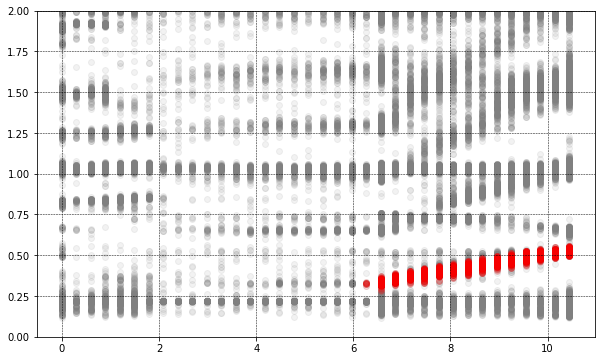

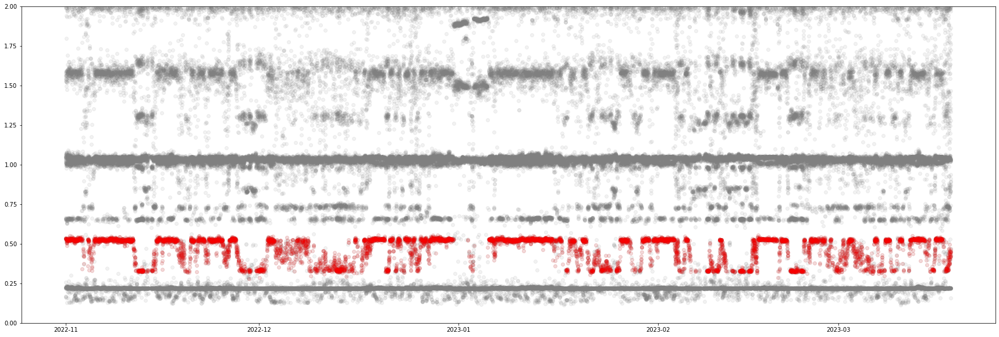

<Figure size 720x432 with 0 Axes>

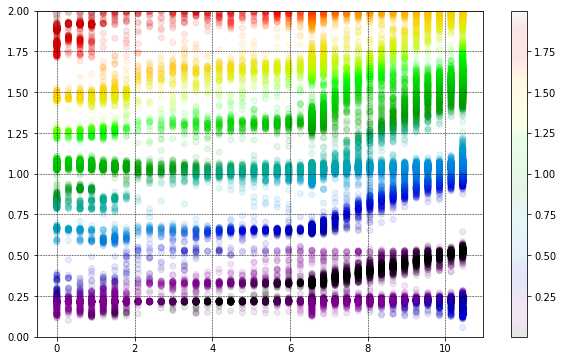

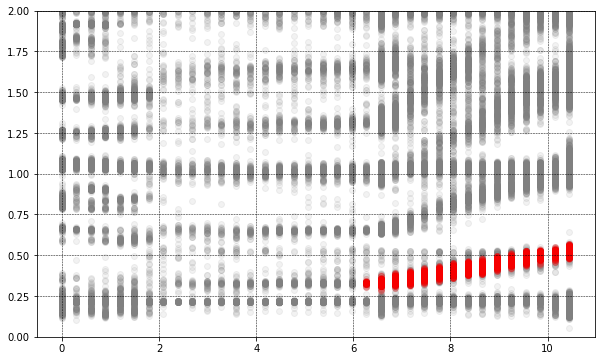

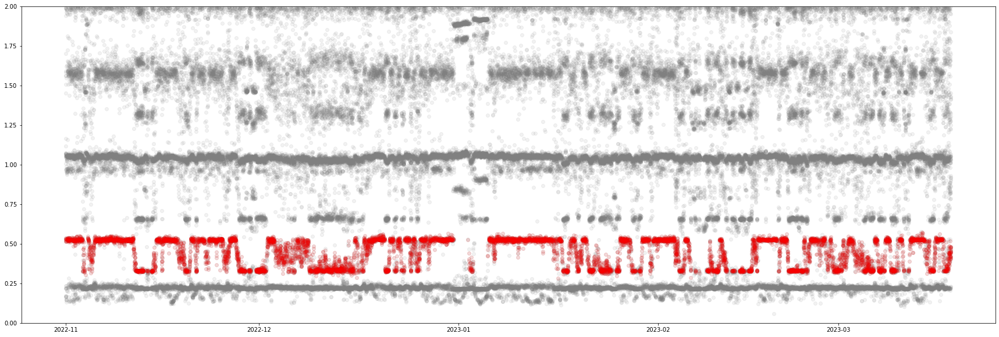

In [268]:
linear_trend_data = {}
distances = {}
p = 3
for direction in ['SS', 'FA']:
    plt.figure(figsize = (10,6))
    plt_data = clustering_data[direction][clustering_data[direction].damping < 10]
    plt_rpm = turbine_data.filter(like='rpm').loc[plt_data.index]
    plt_data = pd.concat([plt_data, plt_rpm], axis=1)[plt_data.frequency < 2]
    linear_trend_data[direction] = plt_data.filter(regex='|'.join(['frequency', 'rpm'])).drop(['std_frequency'], axis=1).dropna()
    distances[direction] = np.abs((p/60 * linear_trend_data[direction].filter(regex='rpm').values[:,0]) - linear_trend_data[direction]['frequency'].values)
    plt.figure(figsize = (10,6))
    plt.scatter(linear_trend_data[direction].filter(regex='rpm'), linear_trend_data[direction]['frequency'], alpha=0.1, c=distances[direction], cmap = 'nipy_spectral')
    plt.grid(True, color='k', linestyle='--', linewidth=0.5)
    cbar = plt.colorbar(alpha=1)
    plt.ylim(0, 2)
    plt.show()
    plt.figure(figsize = (10,6))
    plt.scatter(linear_trend_data[direction].filter(regex='rpm'), linear_trend_data[direction]['frequency'], alpha=0.1, color = 'grey')
    linear_mode = linear_trend_data[direction][distances[direction] < 0.05]
    linear_mode = linear_mode[(linear_mode.filter(regex='rpm') > 6).values]
    plt.scatter(linear_mode.filter(regex='rpm'), linear_mode['frequency'], alpha=0.1, color = 'red')
    plt.grid(True, color='k', linestyle='--', linewidth=0.5)
    plt.ylim(0, 2)
    plt.show()
    plt.figure(figsize = (30,10))
    plt.scatter(linear_trend_data[direction].index, linear_trend_data[direction].frequency, c='grey', alpha=0.1)
    plt.scatter(linear_mode.index, linear_mode.frequency, c='red', alpha=0.1)
    plt.ylim(0, 2)
    plt.show()
    
    


<Figure size 720x432 with 0 Axes>

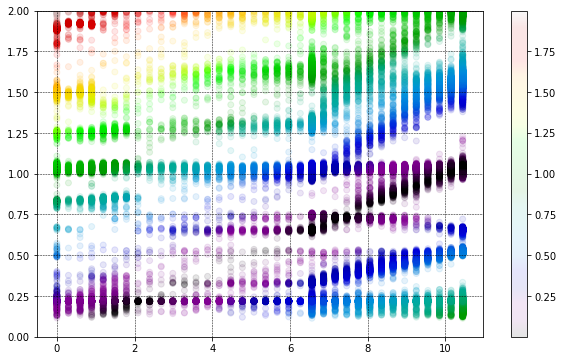

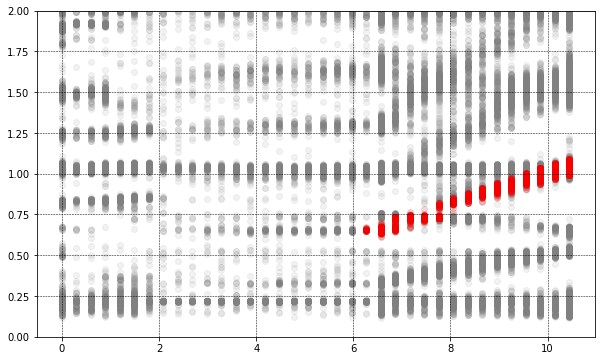

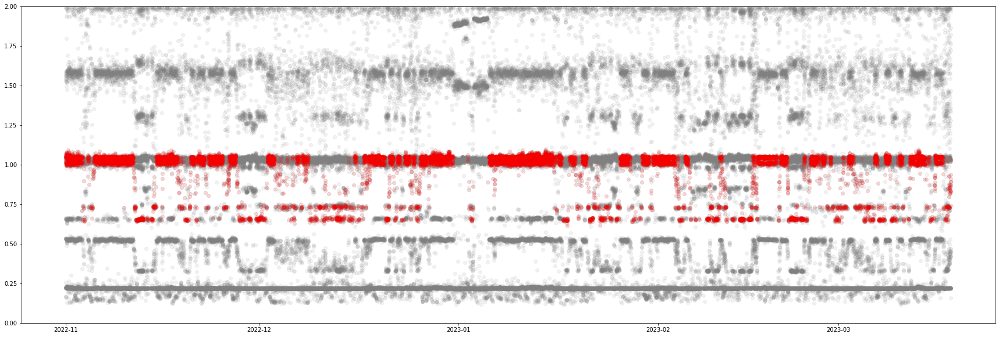

<Figure size 720x432 with 0 Axes>

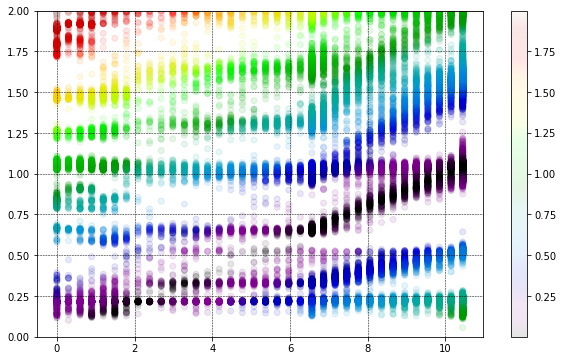

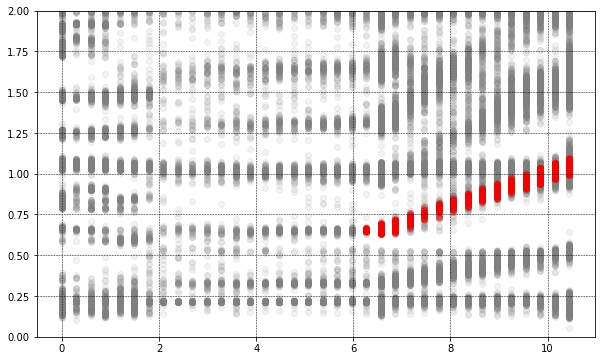

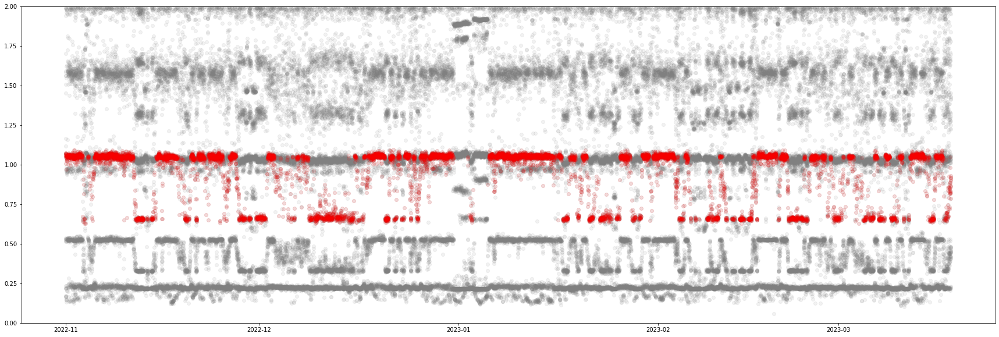

In [269]:
linear_trend_data = {}
distances = {}
p = 6
for direction in ['SS', 'FA']:
    plt.figure(figsize = (10,6))
    plt_data = clustering_data[direction][clustering_data[direction].damping < 10]
    plt_rpm = turbine_data.filter(like='rpm').loc[plt_data.index]
    plt_data = pd.concat([plt_data, plt_rpm], axis=1)[plt_data.frequency < 2]
    linear_trend_data[direction] = plt_data.filter(regex='|'.join(['frequency', 'rpm'])).drop(['std_frequency'], axis=1).dropna()
    distances[direction] = np.abs((p/60 * linear_trend_data[direction].filter(regex='rpm').values[:,0]) - linear_trend_data[direction]['frequency'].values)
    plt.figure(figsize = (10,6))
    plt.scatter(linear_trend_data[direction].filter(regex='rpm'), linear_trend_data[direction]['frequency'], alpha=0.1, c=distances[direction], cmap = 'nipy_spectral')
    plt.grid(True, color='k', linestyle='--', linewidth=0.5)
    cbar = plt.colorbar()
    plt.ylim(0, 2)
    plt.show()
    plt.figure(figsize = (10,6))
    plt.scatter(linear_trend_data[direction].filter(regex='rpm'), linear_trend_data[direction]['frequency'], alpha=0.1, color = 'grey')
    linear_mode = linear_trend_data[direction][distances[direction] < 0.05]
    linear_mode = linear_mode[(linear_mode.filter(regex='rpm') > 6).values]
    plt.scatter(linear_mode.filter(regex='rpm'), linear_mode['frequency'], alpha=0.1, color = 'red')
    plt.grid(True, color='k', linestyle='--', linewidth=0.5)
    plt.ylim(0, 2)
    plt.show()
    plt.figure(figsize = (30,10))
    plt.scatter(linear_trend_data[direction].index, linear_trend_data[direction].frequency, c='grey', alpha=0.1)
    plt.scatter(linear_mode.index, linear_mode.frequency, c='red', alpha=0.1)
    plt.ylim(0, 2)
    plt.show()

<Figure size 720x432 with 0 Axes>

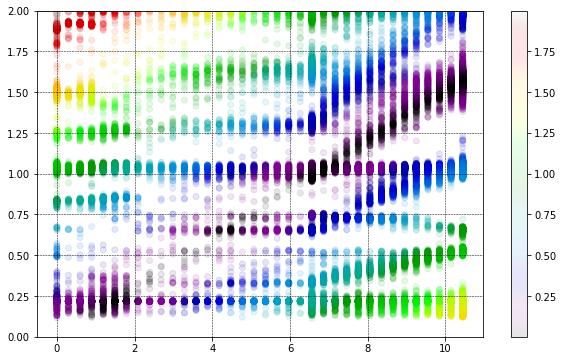

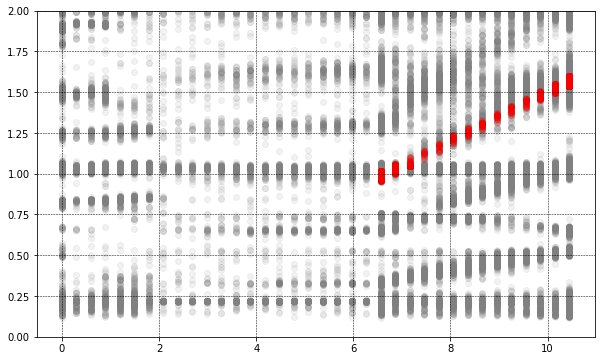

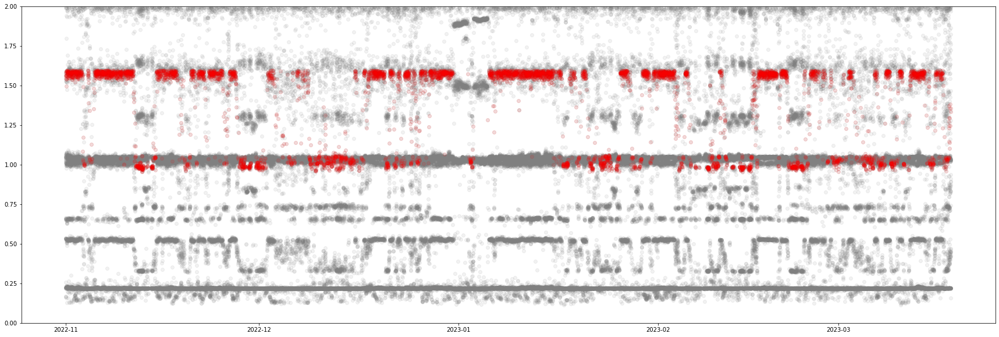

<Figure size 720x432 with 0 Axes>

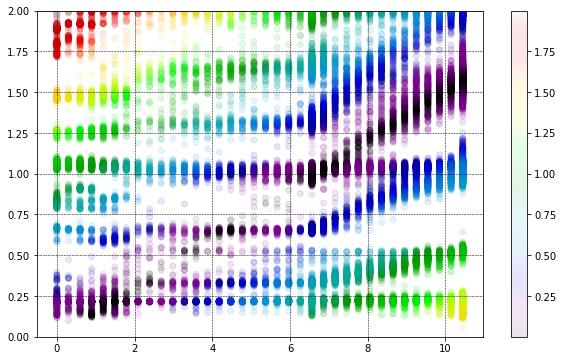

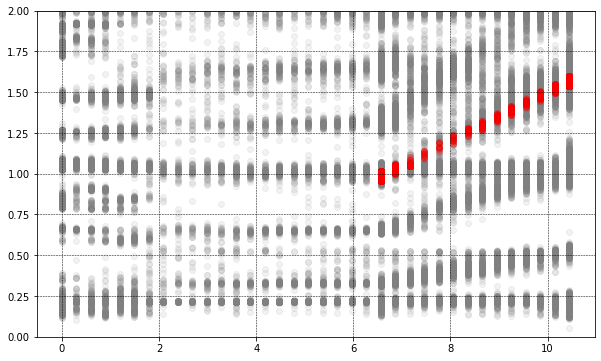

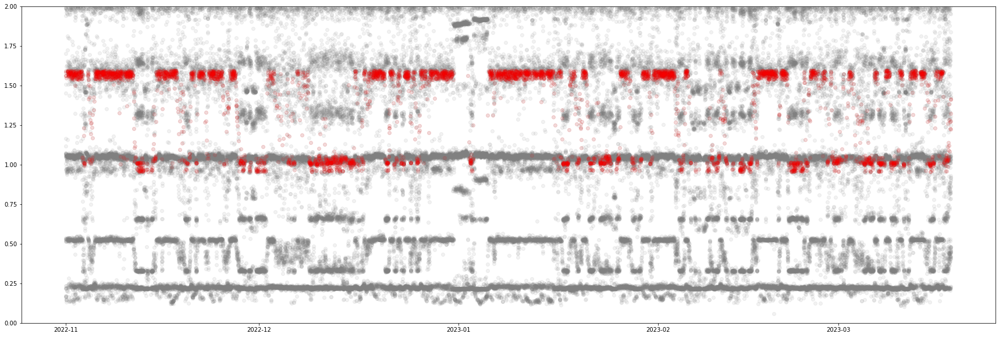

In [270]:
linear_trend_data = {}
distances = {}
p = 9
for direction in ['SS', 'FA']:
    plt.figure(figsize = (10,6))
    plt_data = clustering_data[direction][clustering_data[direction].damping < 10]
    plt_rpm = turbine_data.filter(like='rpm').loc[plt_data.index]
    plt_data = pd.concat([plt_data, plt_rpm], axis=1)[plt_data.frequency < 2]
    linear_trend_data[direction] = plt_data.filter(regex='|'.join(['frequency', 'rpm'])).drop(['std_frequency'], axis=1).dropna()
    distances[direction] = np.abs((p/60 * linear_trend_data[direction].filter(regex='rpm').values[:,0]) - linear_trend_data[direction]['frequency'].values)
    plt.figure(figsize = (10,6))
    plt.scatter(linear_trend_data[direction].filter(regex='rpm'), linear_trend_data[direction]['frequency'], alpha=0.1, c=distances[direction], cmap = 'nipy_spectral')
    plt.grid(True, color='k', linestyle='--', linewidth=0.5)
    cbar = plt.colorbar()
    plt.ylim(0, 2)
    plt.show()
    plt.figure(figsize = (10,6))
    plt.scatter(linear_trend_data[direction].filter(regex='rpm'), linear_trend_data[direction]['frequency'], alpha=0.1, color = 'grey')
    linear_mode = linear_trend_data[direction][distances[direction] < 0.03]
    linear_mode = linear_mode[(linear_mode.filter(regex='rpm') > 6.5).values]
    plt.scatter(linear_mode.filter(regex='rpm'), linear_mode['frequency'], alpha=0.1, color = 'red')
    plt.grid(True, color='k', linestyle='--', linewidth=0.5)
    plt.ylim(0, 2)
    plt.show()
    plt.figure(figsize = (30,10))
    plt.scatter(linear_trend_data[direction].index, linear_trend_data[direction].frequency, c='grey', alpha=0.1)
    plt.scatter(linear_mode.index, linear_mode.frequency, c='red', alpha=0.1)
    plt.ylim(0, 2)
    plt.show()

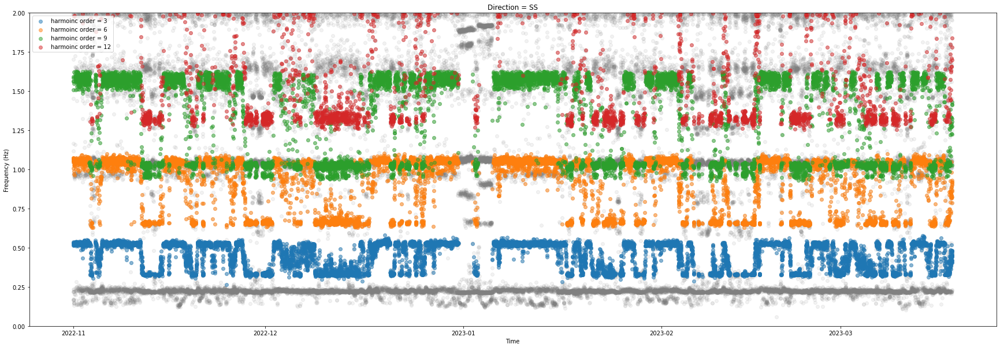

c:\Users\Max\anaconda3\envs\soiltwin\lib\site-packages\IPython\core\pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


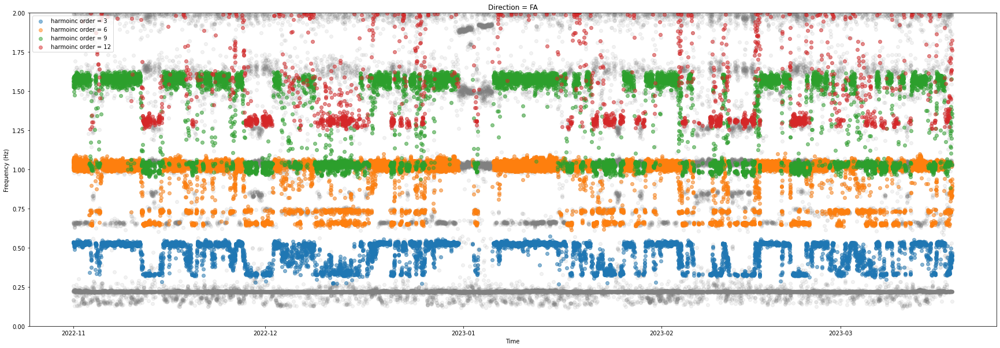

In [275]:
linear_trend_data = {}
distances = {}
linear_modes = {}
p = 9
for direction in ['SS', 'FA']:
    distances[direction] = {}
    linear_modes[direction] = {}
    linear_trend_data[direction] = plt_data.filter(regex='|'.join(['frequency', 'rpm'])).drop(['std_frequency'], axis=1).dropna()
    plt_data = clustering_data[direction][clustering_data[direction].damping < 10]
    plt_rpm = turbine_data.filter(like='rpm').loc[plt_data.index]
    plt_data = pd.concat([plt_data, plt_rpm], axis=1)[plt_data.frequency < 2]
    plt.figure(figsize = (30,10))
    plt.scatter(linear_trend_data[direction].index, linear_trend_data[direction].frequency, c='grey', alpha=0.1)
    for p in [3, 6, 9, 12]:
        distances[direction][p] = np.abs((p/60 * linear_trend_data[direction].filter(regex='rpm').values[:,0]) - linear_trend_data[direction]['frequency'].values)
        linear_modes[direction][p] = linear_trend_data[direction][distances[direction][p] < 0.06]
        linear_modes[direction][p] = linear_modes[direction][p][(linear_modes[direction][p].filter(regex='rpm') > 6).values]       
        plt.scatter(linear_modes[direction][p].index, linear_modes[direction][p].frequency, alpha=0.5, label='harmoinc order = {}'.format(p))
    plt.xlabel('Time')
    plt.ylabel('Frequency (Hz)')
    plt.title('Direction = {}'.format(direction))
    plt.ylim(0, 2)
    plt.legend()
    plt.show()

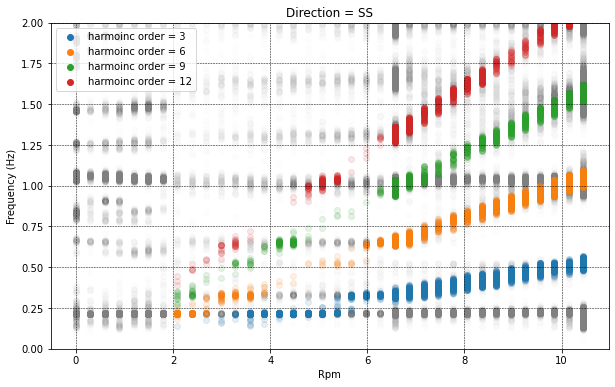

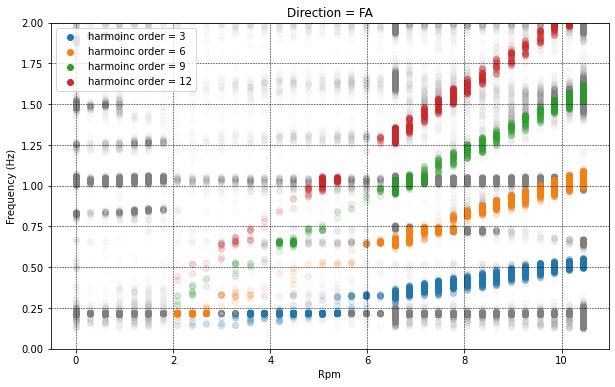

In [276]:
linear_trend_data = {}
distances = {}
linear_modes = {}
p = 9
for direction in ['SS', 'FA']:
    distances[direction] = {}
    linear_modes[direction] = {}
    linear_trend_data[direction] = plt_data.filter(regex='|'.join(['frequency', 'rpm'])).drop(['std_frequency'], axis=1).dropna()
    plt_data = clustering_data[direction][clustering_data[direction].damping < 10]
    plt_rpm = turbine_data.filter(like='rpm').loc[plt_data.index]
    plt_data = pd.concat([plt_data, plt_rpm], axis=1)[plt_data.frequency < 2]
    plt.figure(figsize = (10,6))
    plt.scatter(linear_trend_data[direction].filter(regex='rpm'), linear_trend_data[direction].frequency, c='grey', alpha=0.01)
    for p in [3, 6, 9, 12]:
        distances[direction][p] = np.abs((p/60 * linear_trend_data[direction].filter(regex='rpm').values[:,0]) - linear_trend_data[direction]['frequency'].values)
        linear_modes[direction][p] = linear_trend_data[direction][distances[direction][p] < 0.05]
        linear_modes[direction][p] = linear_modes[direction][p][(linear_modes[direction][p].filter(regex='rpm') > 2).values]       
        plt.scatter(linear_modes[direction][p].filter(regex='rpm'), linear_modes[direction][p].frequency, alpha=0.1, label='harmoinc order = {}'.format(p))
    plt.xlabel('Rpm')
    plt.ylabel('Frequency (Hz)')
    plt.title('Direction = {}'.format(direction))
    plt.ylim(0, 2)
    legend = plt.legend()
    plt.grid(True, color='k', linestyle='--', linewidth=0.5)
    for handle in legend.legendHandles:
        handle.set_alpha(1.0)

    plt.show()

In [157]:
linear_trend_data[direction].filter(regex='rpm') > 10

,mean_NW2_C02_rpm
timestamp,
2022-11-01 00:00:00+00:00,True
2022-11-01 00:00:00+00:00,True
2022-11-01 00:00:00+00:00,True
2022-11-01 00:00:00+00:00,True
2022-11-01 00:00:00+00:00,True
...,...
2023-03-18 10:30:00+00:00,False
2023-03-18 10:40:00+00:00,False
2023-03-18 10:40:00+00:00,False


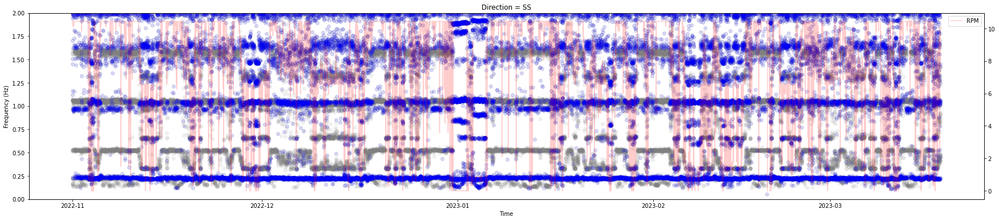

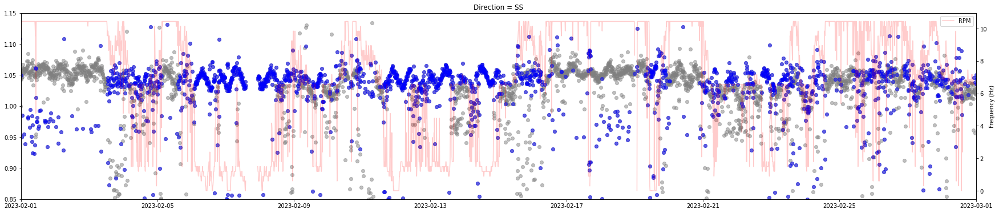

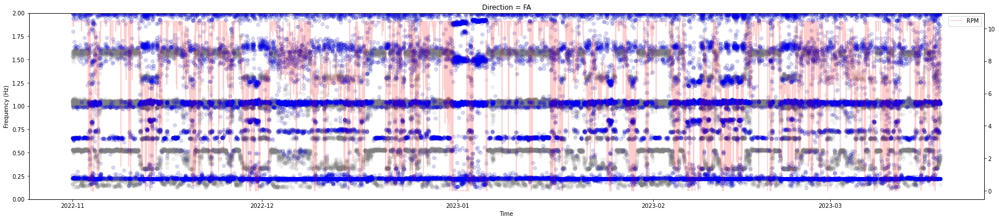

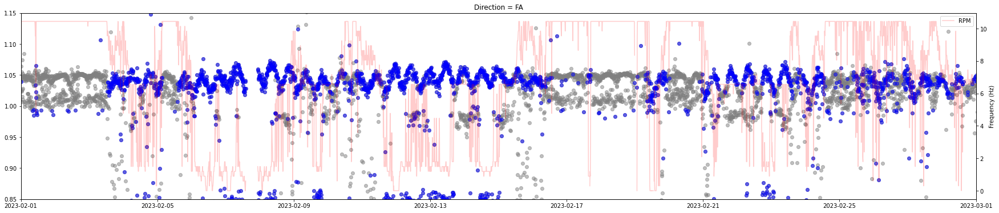

In [204]:
linear_trend_data = {}
distances = {}
linear_modes = {}
harmonics_removed = {}
p = 9
for direction in ['SS', 'FA']:
    distances[direction] = {}
    linear_modes[direction] = {}
    linear_trend_data[direction] = plt_data.filter(regex='|'.join(['frequency', 'rpm'])).drop(['std_frequency'], axis=1).dropna()
    plt_data = clustering_data[direction][clustering_data[direction].damping < 10]
    plt_rpm = data.filter(like='rpm').loc[plt_data.index]
    plt_data = pd.concat([plt_data, plt_rpm], axis=1)[plt_data.frequency < 2]
    fig, ax1 = plt.subplots(figsize = (30,6))
    ax1.scatter(linear_trend_data[direction].index, linear_trend_data[direction].frequency, c='grey', alpha=0.1)
    
    for p in [1,3, 6, 9, 12]:
        distances[direction][p] = np.abs((p/60 * linear_trend_data[direction].filter(regex='rpm').values[:,0]) - linear_trend_data[direction]['frequency'].values)
        linear_trend_data[direction]['distance_{}'.format(p)] = distances[direction][p]
        linear_trend_data[direction].loc[linear_trend_data[direction].filter(regex='rpm')[linear_trend_data[direction].filter(regex='rpm')<2].dropna().index, 'distance_{}'.format(p)] = 1
    harmonics_removed[direction] = linear_trend_data[direction].copy()
    harmonics_removed[direction] = harmonics_removed[direction][harmonics_removed[direction].filter(regex='distance').min(axis=1) > 0.05]
    
    ax1.scatter(harmonics_removed[direction].index, harmonics_removed[direction].frequency, c='blue', alpha=0.1)
    plt.xlabel('Time')
    plt.ylabel('Frequency (Hz)')
    plt.title('Direction = {}'.format(direction))
    plt.ylim(0, 2)
    ax2 = ax1.twinx()
    ax2.plot(data.filter(like='rpm').index, data.filter(like='rpm').values, color='r', alpha=0.2, label='RPM')
    plt.legend()
    plt.show()
    fig, ax1 = plt.subplots(figsize = (30,6))
    ax1.scatter(linear_trend_data[direction].index, linear_trend_data[direction].frequency, c='grey', alpha=0.5)
    ax1.scatter(harmonics_removed[direction].index, harmonics_removed[direction].frequency, c='blue', alpha=0.5)
    plt.ylim(0.85, 1.15)
    ax2 = ax1.twinx()    
    ax2.plot(data.filter(like='rpm').index, data.filter(like='rpm').values, color='r', alpha=0.2, label='RPM')
    plt.xlabel('Time')
    plt.ylabel('Frequency (Hz)')
    plt.title('Direction = {}'.format(direction))
    
    plt.xlim(datetime.datetime(2023, 2, 1), datetime.datetime(2023, 3, 1))
    plt.legend()
    plt.show()

## Cluster the modes without harmonics

In [22]:
import numpy as np
from sklearn.cluster import DBSCAN
from sklearn.linear_model import LinearRegression

dbscan = {}
clusters = {}
linear_trend_data = {}
for direction in ['SS', 'FA']:
    plt.figure(figsize = (10,6))
    plt_data = clustering_data[direction][clustering_data[direction].damping < 10]
    plt_rpm = data.filter(like='rpm').loc[plt_data.index]
    plt_data = pd.concat([plt_data, plt_rpm], axis=1)
    
    linear_trend_data[direction] = plt_data.filter(regex='|'.join(['frequency', 'rpm'])).drop(['std_frequency'], axis=1).dropna()
    # Step 2: Compute the covariance matrix and its inverse
    X = linear_trend_data[direction]

    dbscan[direction] = DBSCAN(eps=0.1, min_samples=10)
    clusters[direction] = dbscan[direction].fit_predict(X)


<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

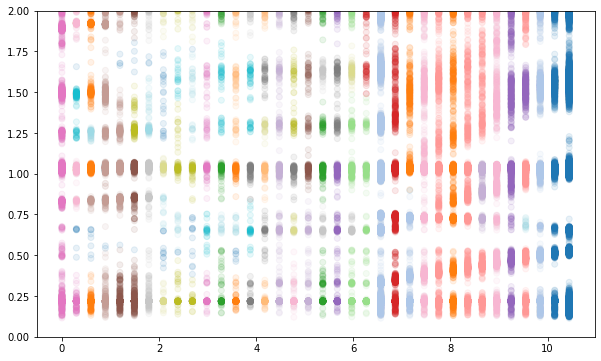

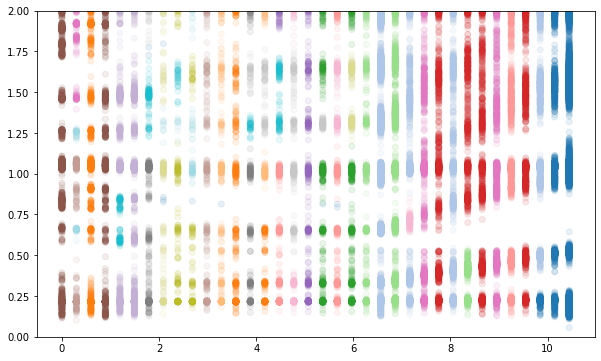

In [23]:
for direction in ['SS', 'FA']:
    linear_trend_data[direction]['clusters'] = clusters[direction]
    plt.figure(figsize = (10,6))
    plt.scatter(linear_trend_data[direction].filter(regex='rpm'), linear_trend_data[direction]['frequency'], alpha=0.1, c=linear_trend_data[direction]['clusters'], cmap = 'tab20')
    plt.ylim(0, 2)